In this project a style is transfered from 'The Japanese Footbridge' done by Claude Monet to a vacation photo. We use here code provided in tensorflow tutorial but we extend it to obtain better results. A first important change is use of average pooling in place of max pooling to increase accuracy of images. Moreover, we define loss function as l1 norm in place of l2. We do not see any justification for using l2-norm. It more heavily penelizes outliers which in case of transfer style are not a problem and we even don't want to match pixels perfectly. Furthermore, we investigate and tune the model with respect to used content and style layers and we implement separate weights for each of the style layers to have more control on the obtained output image. Finally, for better image denoising the total variational loss is used.

### Import libraries

In [1]:
import os
import tensorflow as tf
import numpy as np
import time
import imageio
import PIL.Image
import functools
# Load compressed models from tensorflow_hub
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'

import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (18, 18)
mpl.rcParams['axes.grid'] = False

### Load data
We copy our images from google drive.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!cp ./drive/MyDrive/style_transfer/content_bali.jpg ./content.jpg
!cp ./drive/MyDrive/style_transfer/monet1.jpg ./style.jpg
!mkdir images

In [4]:
content_path = './content.jpg'
style_path = './style.jpg'

### Define helper functions
We define functions that will help us operate on images.  

In [5]:
def tensor_to_numpy(tensor):
  """
  Converts a tf.tensor into a numpy array.
  """
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return tensor

In [6]:
def load_img(path_to_img):
  """
  Loads an image, scales it down and transforms it into a tf.variable.
  """
  max_dim = 768
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

We define a function that will add noise to our input image. In that way the convergence will be faster than in case of fully random noise and the image will be more easily pushed towards a style than in a case were content image would be used as the input.

In [7]:
def generate_noise_image(content_image, noise_ratio=0.5):
    """
    Generates a noisy image by adding random noise to a content_image.
    """
    
    noise_image = np.random.uniform(-1, 1, (1, content_image.shape[1],
                  content_image.shape[2], content_image.shape[3])).astype('float32')
    
    input_image = noise_image * noise_ratio + content_image * (1 - noise_ratio)
    
    return input_image

In [8]:
def imshow(image, title=None):
  """
  Plot an image with a title by means of matplotlib.plt.
  """
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis=0)

  plt.imshow(image)
  if title:
    plt.title(title)

### Images investigation
Let's see our content and style images.

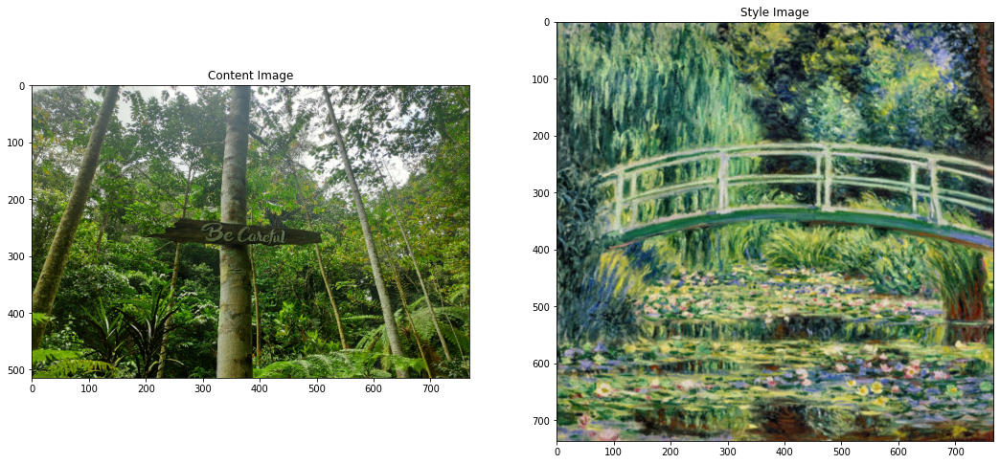

In [9]:
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

The content image is a photography of jungle with a 'Be Careful' board. Our style image is a painting done by Claude Monet, one of the founders of the impressionism. Depending on the hyperparameters we should be able to decide about the level of detailness that will be in our output image.  
### Load VGG19 model
We load a pretrained VGG-19 that will be used to assess the content and style loss. VGG family is known as a good neural network for transfer learning.  
First we print the available layers.

In [10]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
for layer in vgg.layers:
  print(layer.name)

80142336/80134624 [==============================] - 0s 0us/step
INFO:tensorflow:Assets written to: temporal_model.mat/assets
input_1
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


We define starting content and style layers.

In [11]:
content_layers = ['block5_conv2'] 

style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']
style_weight = [0.2, 0.2, 0.2, 0.2, 0.2]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

And we define function that provide us a model-extractor. It will be used to obtain values of intermediate convulation layers for the content and style transfer.

In [12]:
def vgg_layers(layer_names):
  """
  Creates a vgg model that returns a list of intermediate output values.
  It changes standard max-pooling layers into avg-pooling to improve
  resolution of images.
  """
  # Load our model. Load pretrained VGG, trained on imagenet data
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.save('temporal_model.mat')
  custom_objects = {'MaxPooling2D': tf.keras.layers.AveragePooling2D}
  vgg = tf.keras.models.load_model('temporal_model.mat', custom_objects = custom_objects)
  vgg.trainable = False

  outputs = [vgg.get_layer(name).output for name in layer_names]

  model = tf.keras.Model([vgg.input], outputs)
  return model

In [13]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

INFO:tensorflow:Assets written to: temporal_model.mat/assets


### Loss and training functions
We define functions that are necessary for style transfer, i.e. responsible for the calculation of loss and training.  
First, we define a gram matrix that is a backbone for style transfer. It calculates correlation between different feature maps of specified convulation layers. In that way style can be seen as occurance of the same combined features in a
given image.

In [14]:
def gram_matrix(input_tensor):
  """
  Calculates a gram matrix used to evaluate style of an image.
  """
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  input_shape = tf.shape(input_tensor)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  return result/(num_locations)

We define a class that will be used to create extractors.

In [15]:
class StyleContentModel(tf.keras.models.Model):
  """
  Returns a dictionary consisting of content and style layers extractor.
  """
  def __init__(self, style_layers, content_layers):
    super(StyleContentModel, self).__init__()
    self.vgg = vgg_layers(style_layers + content_layers)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = False

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                      outputs[self.num_style_layers:])

    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]

    content_dict = {content_name: value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name: value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

    return {'content': content_dict, 'style': style_dict}

We make function to wrap up the model creation.

In [16]:
def make_targets(style_layers, content_layers, content_image):
  """
  Return extractor and content and style targets that will be used in a loss function.
  """
  extractor = StyleContentModel(style_layers, content_layers)
  style_targets = extractor(style_image)['style']
  content_targets = extractor(content_image)['content']
  return extractor, style_targets, content_targets

Finally we define the loss function.

In [17]:
def style_content_loss(outputs):
    """
    Calculates style and constent loss based on l1-norm.
    """
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean(style_weight[i]*tf.math.abs(style_outputs[name]-style_targets[name])) 
                           for i, name in enumerate(style_outputs.keys())])
    
    content_loss = tf.add_n([tf.reduce_mean(tf.math.abs(content_outputs[name]-content_targets[name]))
                             for name in content_outputs.keys()])
    loss = (1.-alpha)*style_loss + alpha*content_loss
    return loss

And also we define a function to clip output image into a valid range.

In [18]:
def clip_0_1(image):
  """
  Clips an image to have pixel values in a valid range.
  """
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

We define the optimizer. Here, ADAM will be used.

In [19]:
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

We wrap optimization into a single function. Within it we define the train_step() function. We do it purposly to prevent errors conneted with gradient tape variables initialization.

In [20]:
def run_opt(name, image, show=True, write=True, epochs = 10, steps_per_epoch = 100):
  """
  Wrap-up function to run transfer style on a chosen function.
  """
  @tf.function()
  def train_step(image):
    """
    Performs a single optimization step.
    """
    with tf.GradientTape() as tape:
      outputs = extractor(image)
      loss = style_content_loss(outputs)
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))
  start = time.time()
  step = 0
  for n in range(epochs):
    for m in range(steps_per_epoch):
      step += 1
      train_step(image)
      print(".", end='')
    img = tensor_to_numpy(image)
    display.clear_output(wait=True)
    if show:
      display.display(PIL.Image.fromarray(img))
    print("Train step: {}".format(step))
  if write:
    imageio.imwrite("images/{}.jpg".format(name), img)
  end = time.time()
  print("Total time: {:.1f}".format(end-start))

### Training  
First let's see how the noise generation works.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


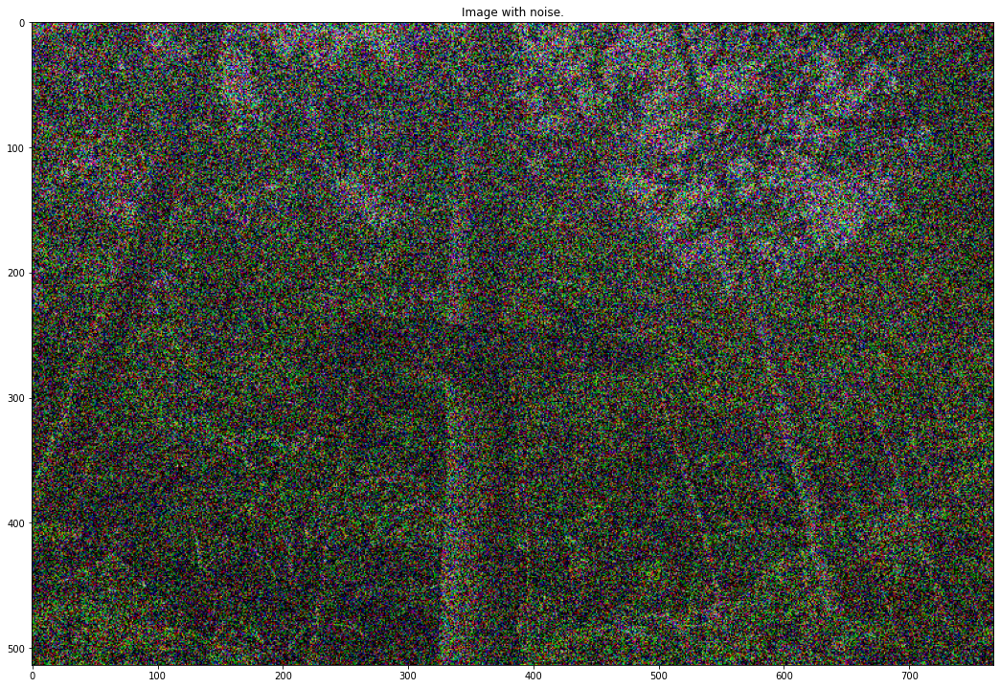

In [21]:
image = content_image
img_60 = generate_noise_image(image, noise_ratio=0.6)
img_60 = tf.Variable(img_60)
imshow(img_60, 'Image with noise.')

And now we run optimization with initially guessed hyper-parameters.

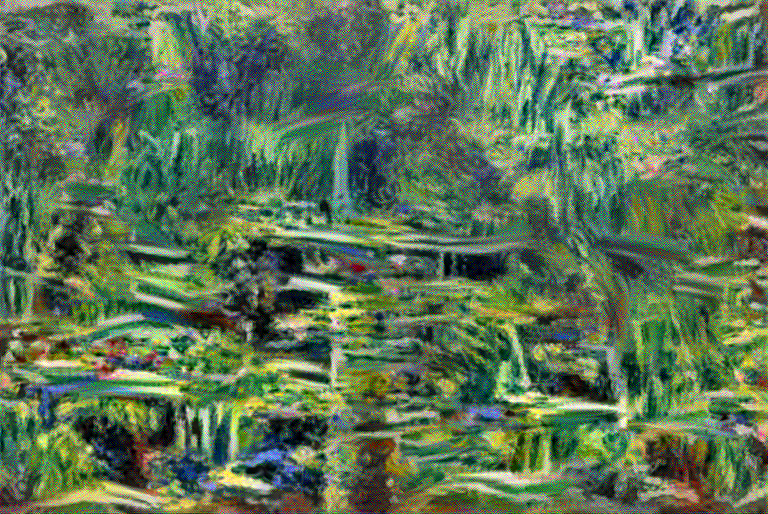

Train step: 2000
Total time: 122.2


In [22]:
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alpha=0.5
style_weight = [0.2, 0.2, 0.2, 0.2, 0.2]
run_opt('equal', img_60, epochs=20)

The style influence is definetly too strong. To fine tune the model we need to choose a right layer for the content and to investigate influence of particular style layers.  
First we run the model with different content layers with alpha set to 1.0.

In [23]:
content_list = ['block5_conv1', 'block4_conv2', 'block4_conv1', 'block3_conv3', 'block3_conv2']
for cl in content_list:
  extractor, style_targets, content_targets = make_targets(style_layers, [cl], content_image)
  image = generate_noise_image(content_image, noise_ratio=0.6)
  image = tf.Variable(image)
  alpha= 1.0
  style_weight = [0.2, 0.2, 0.2, 0.2, 0.2]
  run_opt('content_{}'.format(cl), image, show=False, epochs=20)

Train step: 2000
Total time: 117.3


In [24]:
def compare_figures(images, names):
  """
  Function to plot and compare 6 figures.
  """
  mpl.rcParams['figure.figsize'] = (22, 22)
  for x in range(6):
    image_show = load_img('{}'.format(images[x]))
    plt.subplot(3, 2, x+1)
    imshow(image_show, names[x])

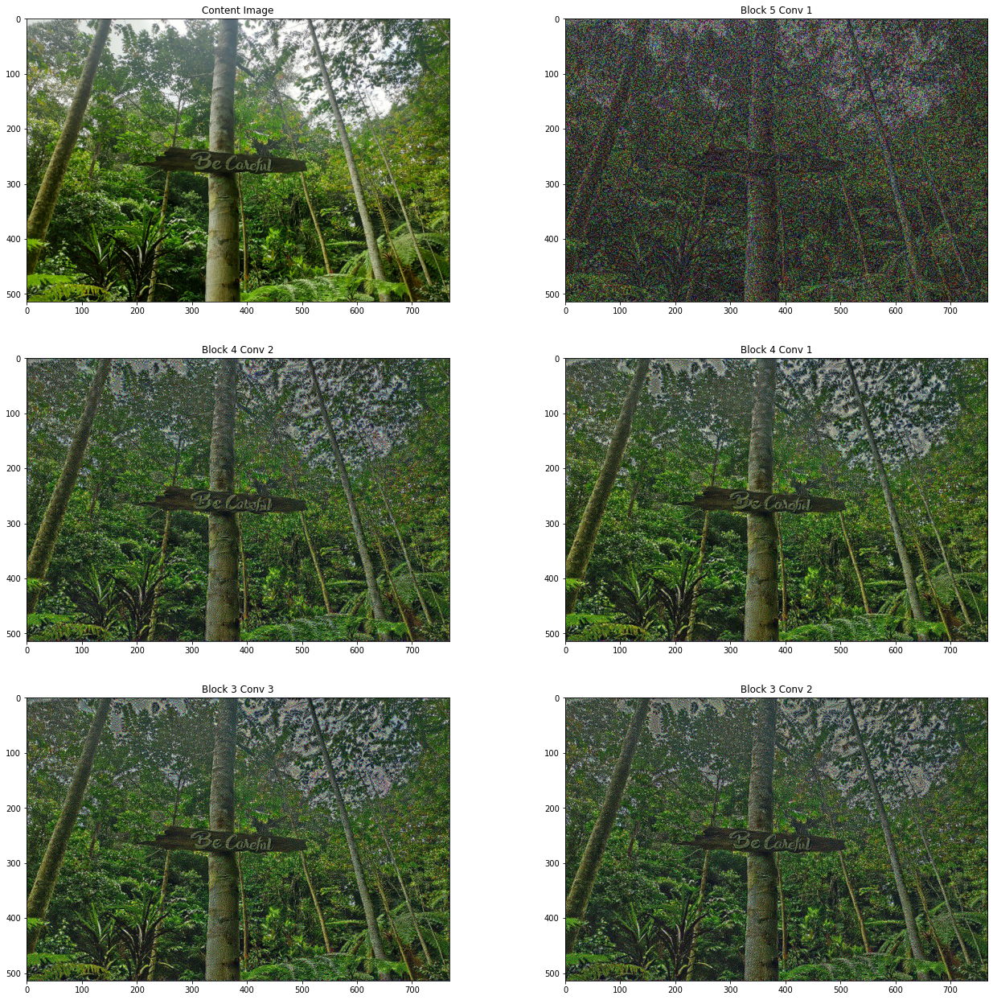

In [25]:
images = ['./content.jpg', './images/content_block5_conv1.jpg', './images/content_block4_conv2.jpg',
          './images/content_block4_conv1.jpg', './images/content_block3_conv3.jpg', './images/content_block3_conv2.jpg']
names = ['Content Image', 'Block 5 Conv 1', 'Block 4 Conv 2', 'Block 4 Conv 1', 'Block 3 Conv 3', 'Block 3 Conv 2']
compare_figures(images, names)

With block 3 conv 3 we are still able to see undistorted incription on the board. We choose it as our content layer.  


As a next step we fine tune the alpha value to get a satisfying output.

In [26]:
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alphas_list = [0.9, 0.95, 0.97, 0.98, 0.99, 0.995]
style_weight = [0.2, 0.2, 0.2, 0.2, 0.2]
for x, al in enumerate(alphas_list):
  image = generate_noise_image(content_image, noise_ratio=0.6)
  image = tf.Variable(image)
  alpha = al
  run_opt('alpha_{:d}'.format(x+1), image, show=False, epochs=20)

Train step: 2000
Total time: 117.5


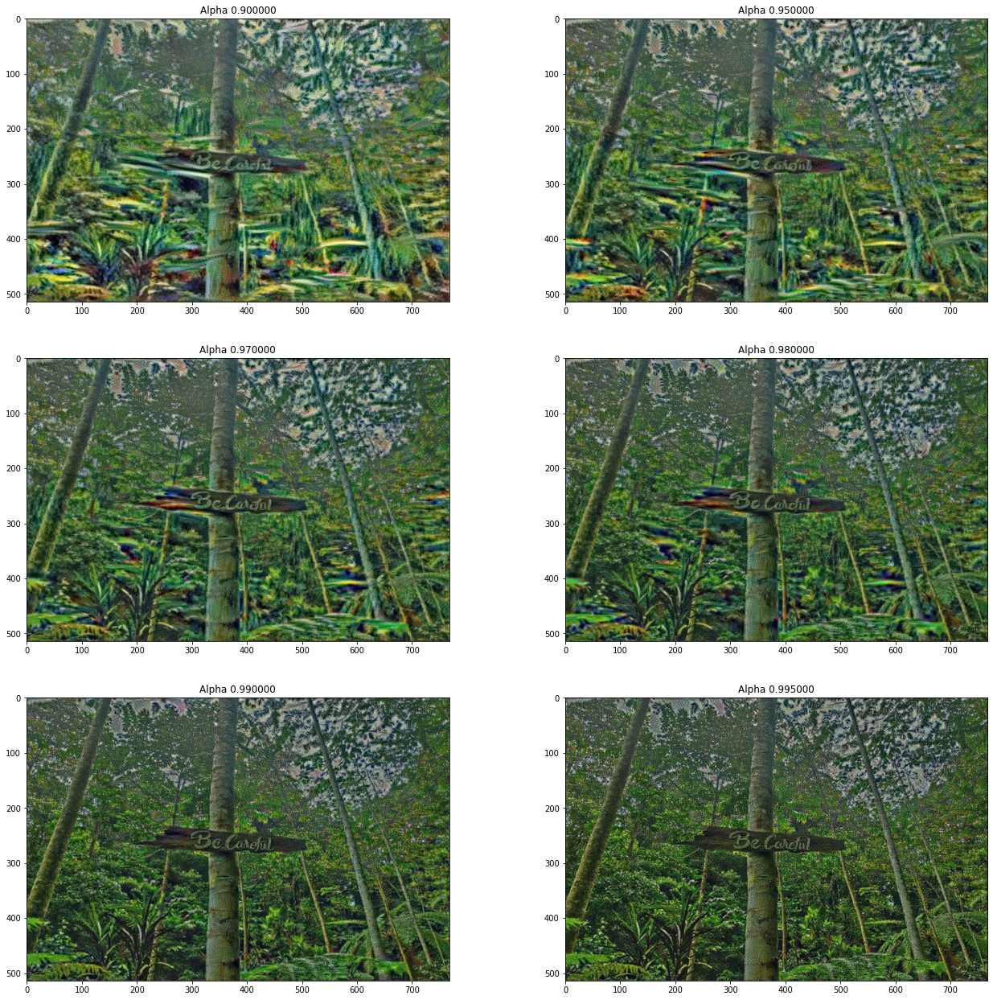

In [27]:
images = []
names = []
for x in range(6):
  images.append('./images/alpha_{:d}.jpg'.format(x+1))
  names.append('Alpha {:1f}'.format(alphas_list[x]))
compare_figures(images, names)

Starting from 0.95 interesting results are observed.   
Now it's time to investigate style layers. We run the model with alpha=0 and all of the layers equally important.

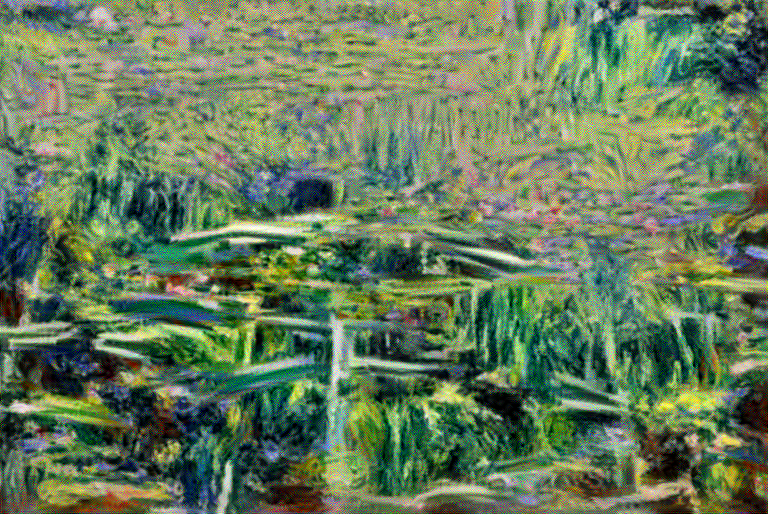

Train step: 2000
Total time: 119.6


In [28]:
content_layers = ['block3_conv3']
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
image = generate_noise_image(content_image, noise_ratio=0.6)
image = tf.Variable(image)
alpha= 0.
style_weight = [0.2, 0.2, 0.2, 0.2, 0.2]
run_opt('equal', image, epochs=20)

And now we check the influence of each individual layer. By setting weight of other style layers to 0 while keeping the chosen one equal to 1.0.

In [29]:
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alpha=0.
for x in range(5):
  image = generate_noise_image(content_image, noise_ratio=0.6)
  image = tf.Variable(image)
  style_weight = [0., 0., 0., 0., 0.]
  style_weight[x] = 1.0
  run_opt('style_only_{:d}'.format(x+1), image, show=False, epochs=20)

Train step: 2000
Total time: 117.3


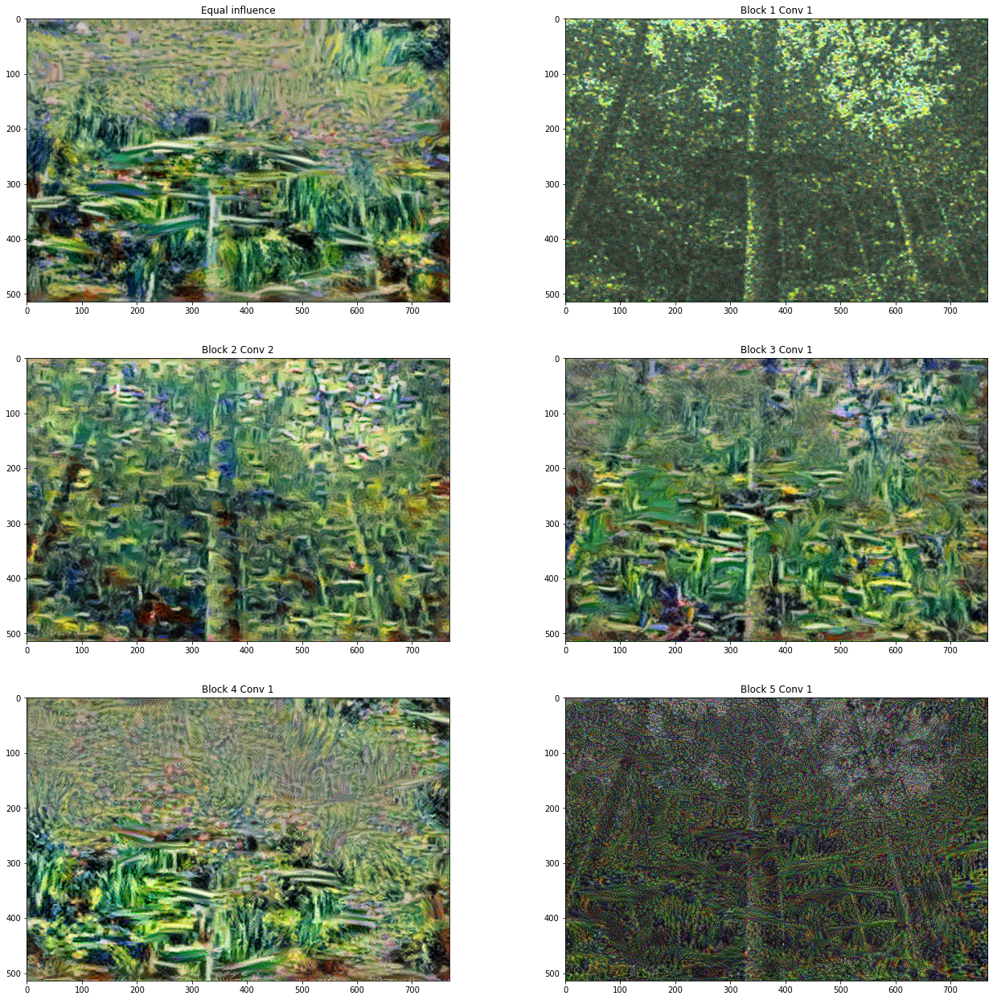

In [30]:
mpl.rcParams['figure.figsize'] = (22, 22)
images = ['./images/equal.jpg', './images/style_only_1.jpg', './images/style_only_2.jpg',
          './images/style_only_3.jpg', './images/style_only_4.jpg', './images/style_only_5.jpg']
names = ['Equal influence', 'Block 1 Conv 1', 'Block 2 Conv 2', 'Block 3 Conv 1', 'Block 4 Conv 1', 'Block 5 Conv 1']
compare_figures(images, names)

Block 4 Conv 1 style seem to be dominant in equal images let's see losses of each of the layers.

In [31]:
values = np.array([tf.reduce_mean(tf.math.abs(style_targets[name])).numpy() for name in style_targets.keys()])
labels = np.array(['Block 1 Conv 1', 'Block 2 Conv 2', 'Block 3 Conv 1', 'Block 4 Conv 1', 'Block 5 Conv 1'])
values_pct = values/np.sum(values)*100

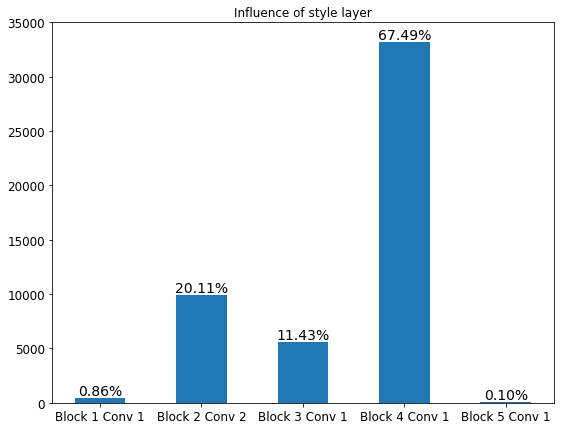

In [32]:
fig, ax = plt.subplots(figsize=(9, 7))
ind = np.arange(len(values))
ax.set_ylim([0,35000])
ax.set_title('Influence of style layer')
ax.bar(ind, values,align='center', width=0.5,tick_label=labels)
for i, pct in enumerate(values_pct):
  ax.annotate('{:.2f}%'.format(pct), (i,values[i]), ha='center', va='bottom', fontsize=14)
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(12)

Clearly block 4 is dominant. Let's make influnce of each layer equal and see what happens.

In [33]:
equal_influence = (np.ones(5)/values)/np.sum(np.ones(5)/values)
print(equal_influence)

[0.10640588 0.0045602  0.00801955 0.00135863 0.87965573]


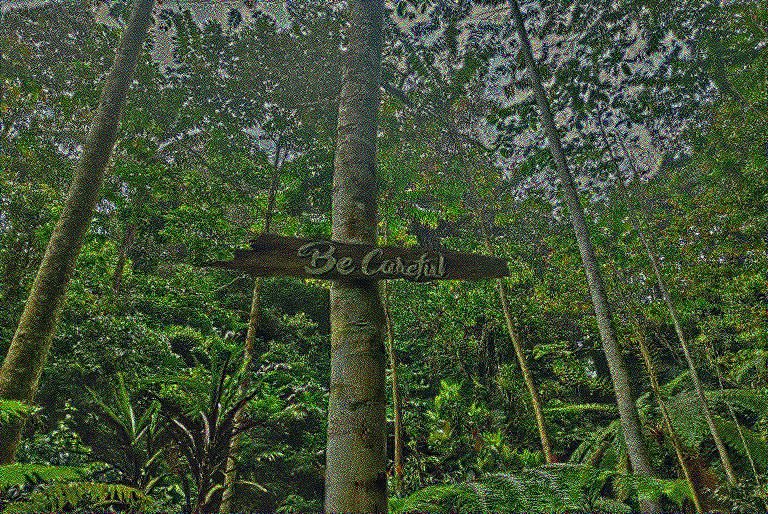

Train step: 2000
Total time: 120.0


In [34]:
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alpha=0.95
image = generate_noise_image(content_image, noise_ratio=0.6)
image = tf.Variable(image)
style_weight = equal_influence
run_opt('equal_style', image, show=True, epochs=20)

The image seem to be too noised and influence of style is too weak. We reduce the weight of last convulation layer and increase the importance of style loss.

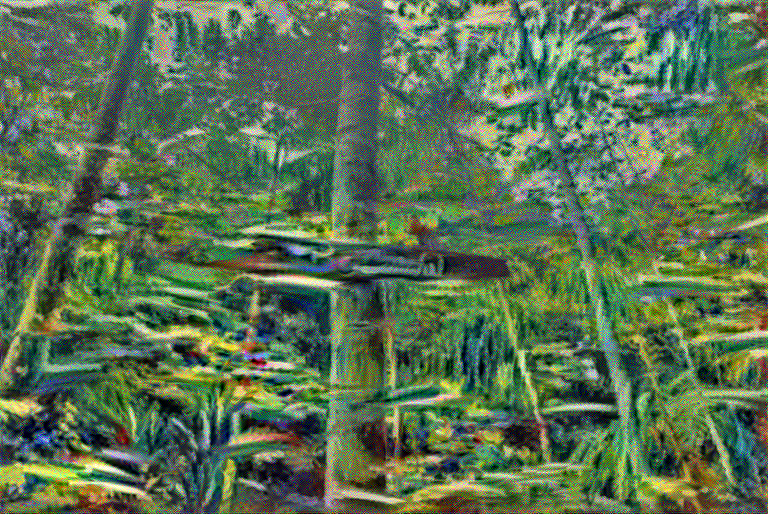

Train step: 2000
Total time: 120.1


In [35]:
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alpha=0.85
image = generate_noise_image(content_image, noise_ratio=0.6)
image = tf.Variable(image)
style_weight = [0.3, 0.2, 0.2, 0.2, 0.1]
run_opt('fine_tune_1', image, show=True, epochs=20)

The image is too blurry. We increase alpha.

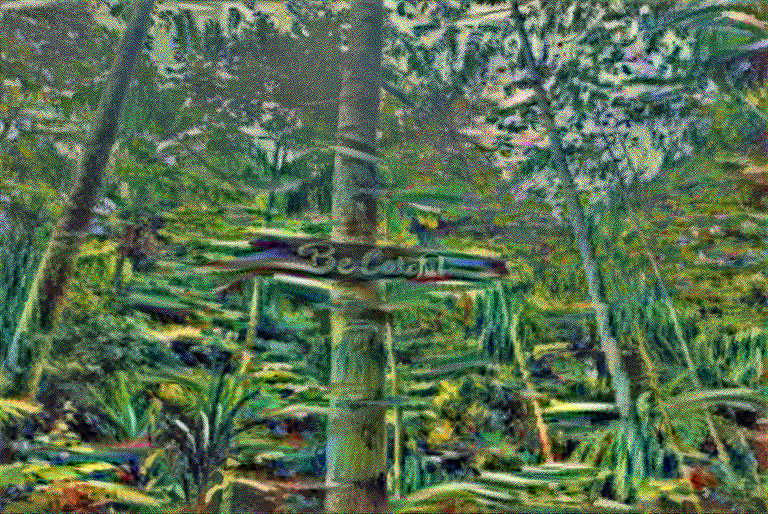

Train step: 2000
Total time: 119.6


In [36]:
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alpha=0.9
image = generate_noise_image(content_image, noise_ratio=0.6)
image = tf.Variable(image)
style_weight = [0.3, 0.2, 0.2, 0.2, 0.1]
run_opt('fine_tune_2', image, show=True, epochs=20)

Still too much. Let's increases it's further.

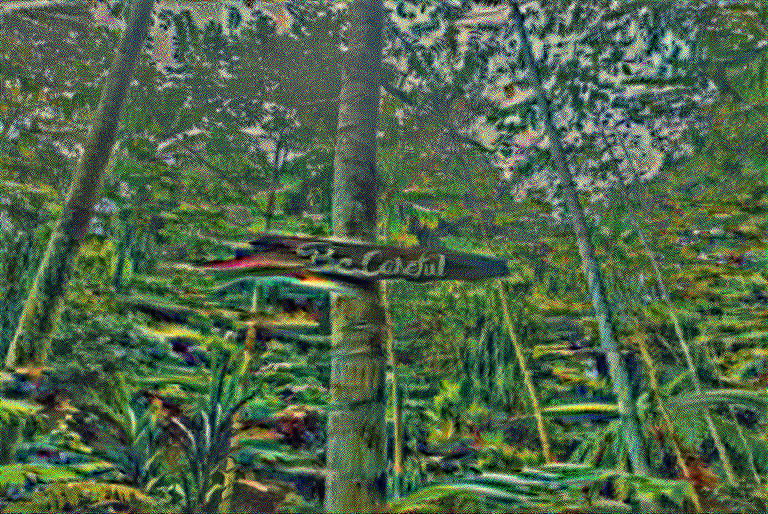

Train step: 2000
Total time: 119.6


In [37]:
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alpha=0.95
image = generate_noise_image(content_image, noise_ratio=0.6)
image = tf.Variable(image)
style_weight = [0.3, 0.2, 0.2, 0.2, 0.1]
run_opt('fine_tune_3', image, show=True, epochs=20)

Alpha=0.95 seem to be enough but still some of features are too blurry. What we can do instead is reduce influence of layers 1 and 4 in favour of 2 and 3 and to reduce the initial noise of the image to get a more crisp design.

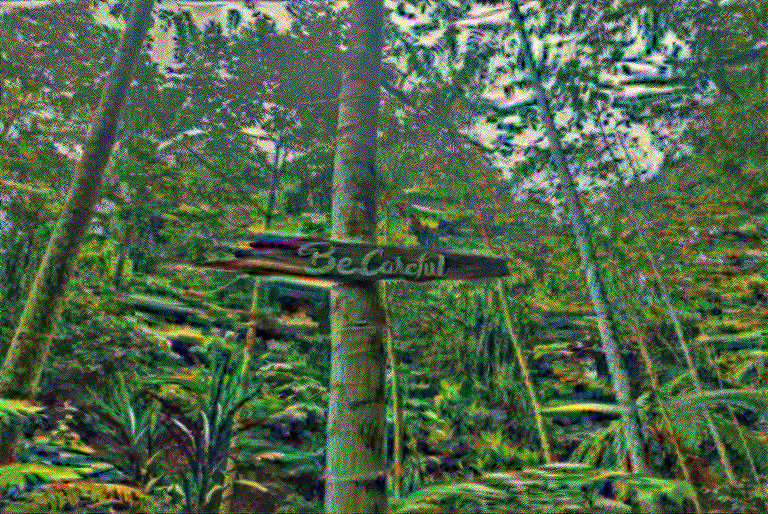

Train step: 2000
Total time: 119.8


In [38]:
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alpha=0.95
image = generate_noise_image(content_image, noise_ratio=0.4)
image = tf.Variable(image)
style_weight = [0.25, 0.25, 0.25, 0.15, 0.1]
run_opt('fine_tune_4', image, show=True, epochs=20)

It helped but let's reduce noise even further.

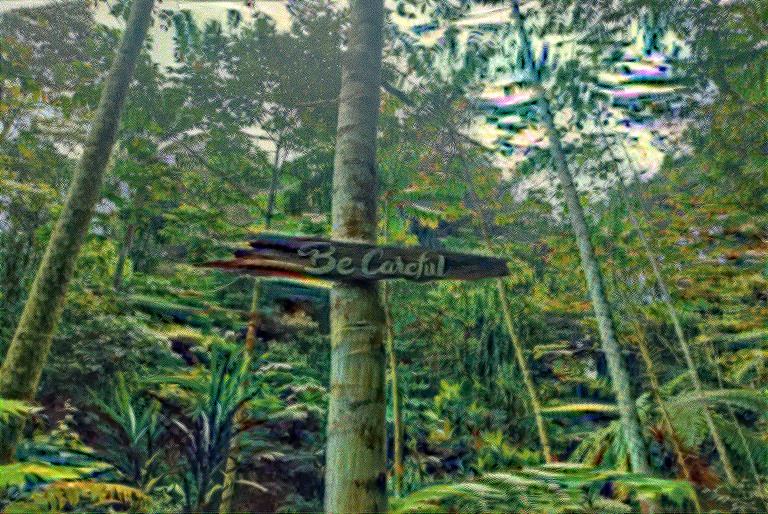

Train step: 2000
Total time: 119.4


In [39]:
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alpha=0.95
image = generate_noise_image(content_image, noise_ratio=0.2)
image = tf.Variable(image)
style_weight = [0.25, 0.25, 0.25, 0.15, 0.1]
run_opt('fine_tune_5', image, show=True, epochs=20)

The results are now satisfying (subjectively). We further improve the design by penelizing high frequency noise by means of total variational loss. For that we use the built-in tensorflow function tf.image.total_variation(). It may blurry images to much but the approach is widely used and is worth checking.

In [40]:
def run_opt(name, image, show=True, write=True, epochs = 10, steps_per_epoch = 100):
  """
  Wrap-up function to run transfer style on a chosen function.
  """
  @tf.function()
  def train_step(image):
    """
    Performs a single optimization step.
    """
    with tf.GradientTape() as tape:
      outputs = extractor(image)
      loss = style_content_loss(outputs)
      #add total variational
      loss += total_variation_weight*tf.image.total_variation(image)
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))
  start = time.time()
  step = 0
  for n in range(epochs):
    for m in range(steps_per_epoch):
      step += 1
      train_step(image)
      print(".", end='')
    img = tensor_to_numpy(image)
    display.clear_output(wait=True)
    if show:
      display.display(PIL.Image.fromarray(img))
    print("Train step: {}".format(step))
  if write:
    imageio.imwrite("images/{}.jpg".format(name), img)
  end = time.time()
  print("Total time: {:.1f}".format(end-start))

In [41]:
weight_list = [0.01, 0.1, 1., 10., 50]
style_weight = [0.25, 0.25, 0.25, 0.15, 0.1]
extractor, style_targets, content_targets = make_targets(style_layers, content_layers, content_image)
alpha=0.95
for x, total_variation_weight in enumerate(weight_list):
  image = generate_noise_image(content_image, noise_ratio=0.6)
  image = tf.Variable(image)
  run_opt('total_variational_{:d}'.format(x+1), image, show=False, epochs=20)

Train step: 2000
Total time: 117.8


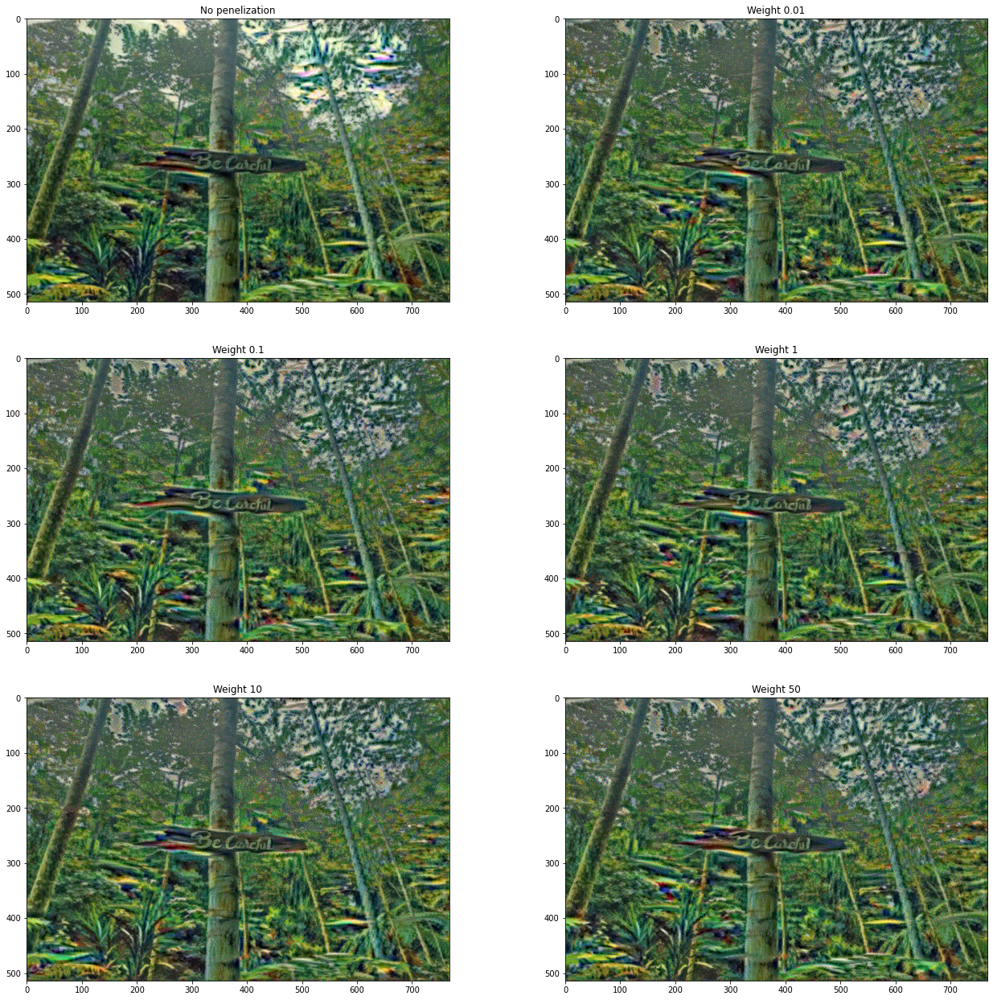

In [42]:
mpl.rcParams['figure.figsize'] = (22, 22)
images = ['./images/fine_tune_5.jpg', './images/total_variational_1.jpg', './images/total_variational_2.jpg',
          './images/total_variational_3.jpg', './images/total_variational_4.jpg', './images/total_variational_5.jpg']
names = ['No penelization', 'Weight 0.01', 'Weight 0.1', 'Weight 1', 'Weight 10', 'Weight 50']
compare_figures(images, names)

Application of variational loss did not help. Results withouth penalization are chosen as the most visually appealing.
### Conclusions
We've successfully transfered an impressionist style into our chosen image. The obtained images are summed up below.

In [43]:
mpl.rcParams['figure.figsize'] = (18, 18)

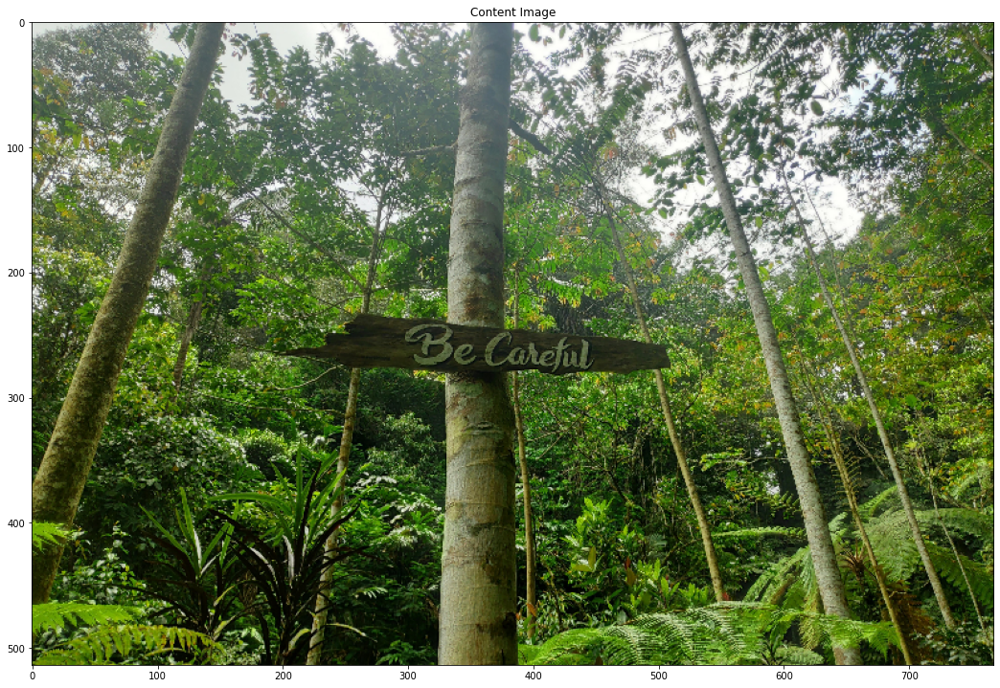

In [44]:
imshow(content_image, 'Content Image')

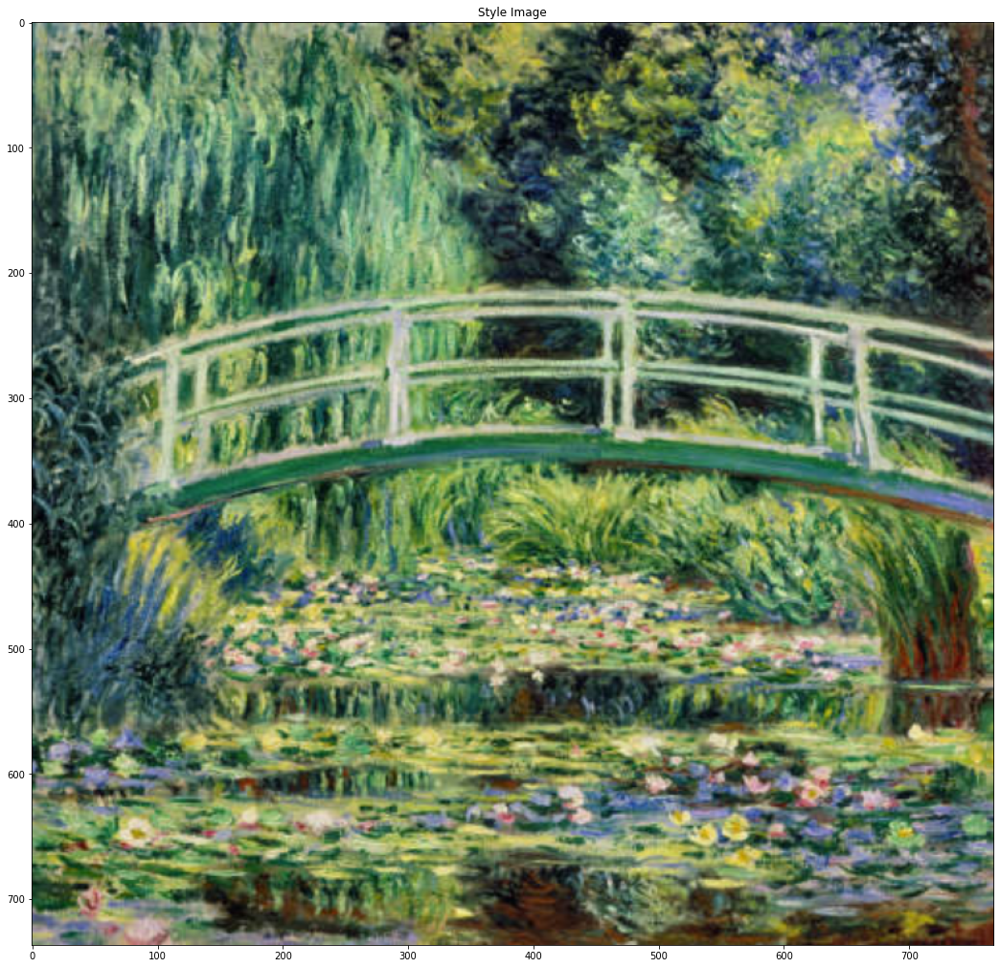

In [45]:
imshow(style_image, 'Style Image')

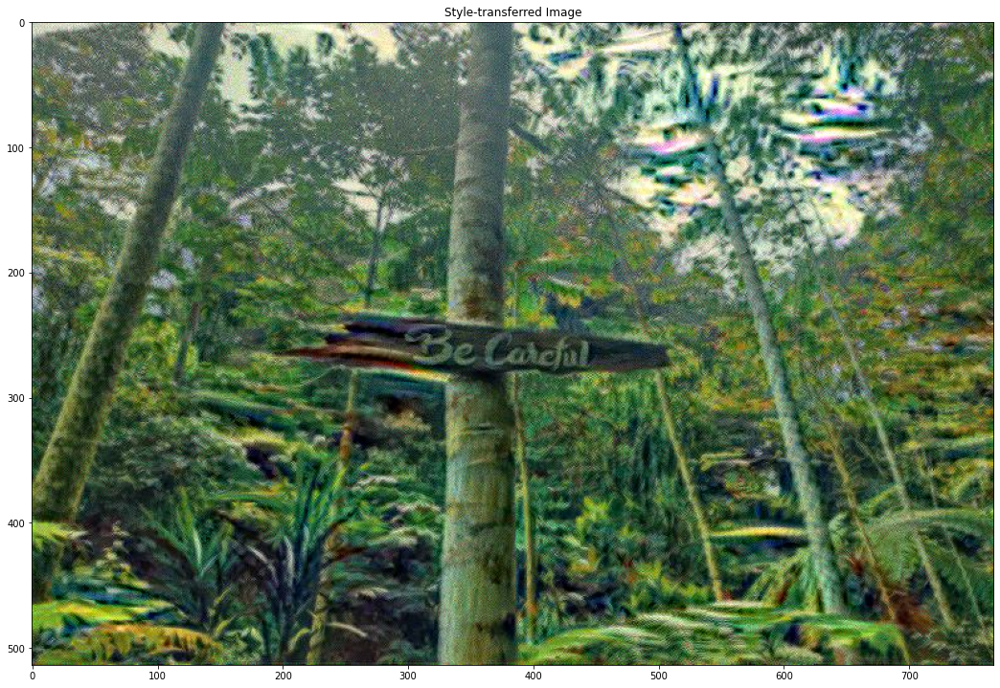

In [46]:
transferred_image = load_img('./images/fine_tune_5.jpg')
imshow(transferred_image, 'Style-transferred Image')